# Optical Character Recognition (OCR) - Google Vision

## 1 Set the environment

### 1.1 Import Libraries

First, We need to import all the necessary libraries for this projet.

In [25]:
import os
from os import path
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw
from PIL import ImageEnhance
import base64
import requests
import json
import ast
import csv

image_path = path.expanduser(r'E:\Users\Usuario\Documents\GitHub_Website\website\japanese_dictionaries\inputs\00-sample-pages_1-cropped.png')
source_img1 = Image.open(image_path)
source_img2 = Image.open(image_path)
source_img3 = Image.open(image_path)
source_img3.putalpha(3)
source_img4 = Image.blend(source_img3, source_img1, 0.3)
source_img5 = Image.open(image_path)
source_img6 = Image.open(image_path)
source_img7 = Image.open(image_path)
source_img7.putalpha(3)
source_img8 = Image.blend(source_img3, source_img1, 0.3)

### 1.2 Set the Google Credentials

For calling the API, we need API key of the Google Vision Service. The following code is commonly used for storing this sensitive information. Once you run them, you can remove the code and call them back again using the os.environ['variable_name'].

In [39]:
# Set the Azure Credentials
#os.environ['GOOGLE_VISION_KEY'] = 'put-google-key'

## 2 Call OCR API

### 2.1 Without Language Hints

In [34]:
#
url = "https://vision.googleapis.com/v1/images:annotate"

key = os.environ['GOOGLE_VISION_KEY']
querystring = {"key":key}
headers = {'Content-Type': "application/json"}

def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read())

def image_request(image_path):

    payload = '{\"requests\":[{\"image\":{\"content\":\"'+encode_image(image_path).decode('utf-8')+'"},\"features\":[{\"type\":\"TEXT_DETECTION\"}]}]}'
    response = requests.request("POST", url, data=payload, headers=headers, params=querystring)

    return ast.literal_eval(response.text)

In [36]:
#Call the API
response_1 = image_request(image_path)

#Save the answer in a csv file
with open('test_ocr.csv', 'w', encoding='utf8') as f:
    
    f.write(str(response_1))


In [37]:
#Load the response saved in the csv file. This avoids repetitive calls (Costs)
with open('test_ocr.csv', 'r', encoding='utf8') as file:
    response = ast.literal_eval(file.read())

The following output shows the API response

In [38]:
response

{'responses': [{'textAnnotations': [{'locale': 'ja',
     'description': '1本の傘た二人でoすこと。多く男女二人の場合に一あS ん影「哀腕](名) 真れにやさしいこと\nあいをん結(哀猿](名) 悲しい撃で噂く猿。\nATAA (Iron] (4)(神短にはなまって、「アイーロ 一あいえん あ 「合線】(名) むっびあふことのでき\nる繰。ーきえん【合縁奇線](名)0合ふも合\nこと。1しん[愛郷心](名) 愛郷の精神。\n\'(愛敬](名) 0人づきの ょいこ\nと。あいそのょいこと。世辞のょいこと。①顔のか」\nはゆらしいこと。@俳優が花道で見物の方へ見たむ\nあいぐん-じょら5ゃくp一愛瑠陰約〕(名)\n愛輝は猪洲国黒龍江省の都合。威曾八年(一八五八)\n清·露の間に黒龍江を雨固の.固境とすることに就い\nて、の地で結ばれた旅約。\nS4° Aるる°\nャ\nAJS4° O又は 微製品。O西洋びの°\n髪の毛をちちらせる小形の鰻。®ルフ用の競の\nゼ 楽 OK時盤な線。\n·(藍翁](名)藍色た帯びてゐぁこと\nーねずみ(藍気鼠](名) (あいれずみ)\n--あいぜん「愛敬愛染](名) 【俳]|あいけぁる\nお°-トャANリン Iron discipline] (¥)| AS-#S 認【相生】 (): に生い出る\n--ざし【相生播](名)男松と\n女松とた揺し、根じめに戴柑子を 用ひたもの。\nの-まつ[相生松](名) 兵庫無加古郡高砂町高砂\n神社の境内の雛松。高砂の松。|-ぼん(相生盆}\n(名)婚騰の折に用ひる男島と女島とを並べた盆景。\n--むすび「相生結](名) 尊通の女結びの一端か\n(あいぜんみょうおう)(愛染明王)。ーあばた[愛\n敬這痕」(名)愛敬があるやうに見たるあばた。一あいけい【愛敬】(名)愛し敬ふこと\n-げ「愛敬毛](名) 女の雲や頭髪のおくれ毛。\nに愛敬を添へろからいふ。|しょうばい\n[愛敬商賓](名)待合。遊郭。愛敬がなくては立|あいげん[愛眼] (名) 【俳J俳の慈悲の眼。\nちゆかぬからいふ。ーずきあい[愛敬附一あい-と [愛顧】(名)且かけてやること。引立て\n合](名)なみなみのつきぁひ。警通の 交際。\nずく 駅)}[愛敬附~](自動、ヵ四

### 2.2 Include Language Hints

In [40]:
#
url = "https://vision.googleapis.com/v1/images:annotate"

key = os.environ['GOOGLE_VISION_KEY']
querystring = {"key":key}
headers = {'Content-Type': "application/json"}

def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read())

def image_request(image_path, hint):

    payload = '{\"requests\":[{\"image\":{\"content\":\"'+encode_image(image_path).decode('utf-8')+'"},\"features\":[{\"type\":\"TEXT_DETECTION\"}],"imageContext":{"languageHints":'+str(hint)+'}}]}'
    response = requests.request("POST", url, data=payload, headers=headers, params=querystring)

    return ast.literal_eval(response.text)

In [7]:
hint = ['ja']
#response_2 = image_request(image_path, hint)

#with open('test_ocr_ja.csv', 'w', encoding='utf8') as f:
    
#    f.write(str(response_1))
        
with open('test_ocr_ja.csv', 'r', encoding='utf8') as file:
    response_ja = ast.literal_eval(file.read())

The following output shows the API response

In [8]:
response_ja

{'responses': [{'textAnnotations': [{'locale': 'ja',
     'description': '1本の傘た二人でoすこと。多く男女二人の場合に一あS ん影「哀腕](名) 真れにやさしいこと\nあいをん結(哀猿](名) 悲しい撃で噂く猿。\nATAA (Iron] (4)(神短にはなまって、「アイーロ 一あいえん あ 「合線】(名) むっびあふことのでき\nる繰。ーきえん【合縁奇線](名)0合ふも合\nこと。1しん[愛郷心](名) 愛郷の精神。\n\'(愛敬](名) 0人づきの ょいこ\nと。あいそのょいこと。世辞のょいこと。①顔のか」\nはゆらしいこと。@俳優が花道で見物の方へ見たむ\nあいぐん-じょら5ゃくp一愛瑠陰約〕(名)\n愛輝は猪洲国黒龍江省の都合。威曾八年(一八五八)\n清·露の間に黒龍江を雨固の.固境とすることに就い\nて、の地で結ばれた旅約。\nS4° Aるる°\nャ\nAJS4° O又は 微製品。O西洋びの°\n髪の毛をちちらせる小形の鰻。®ルフ用の競の\nゼ 楽 OK時盤な線。\n·(藍翁](名)藍色た帯びてゐぁこと\nーねずみ(藍気鼠](名) (あいれずみ)\n--あいぜん「愛敬愛染](名) 【俳]|あいけぁる\nお°-トャANリン Iron discipline] (¥)| AS-#S 認【相生】 (): に生い出る\n--ざし【相生播](名)男松と\n女松とた揺し、根じめに戴柑子を 用ひたもの。\nの-まつ[相生松](名) 兵庫無加古郡高砂町高砂\n神社の境内の雛松。高砂の松。|-ぼん(相生盆}\n(名)婚騰の折に用ひる男島と女島とを並べた盆景。\n--むすび「相生結](名) 尊通の女結びの一端か\n(あいぜんみょうおう)(愛染明王)。ーあばた[愛\n敬這痕」(名)愛敬があるやうに見たるあばた。一あいけい【愛敬】(名)愛し敬ふこと\n-げ「愛敬毛](名) 女の雲や頭髪のおくれ毛。\nに愛敬を添へろからいふ。|しょうばい\n[愛敬商賓](名)待合。遊郭。愛敬がなくては立|あいげん[愛眼] (名) 【俳J俳の慈悲の眼。\nちゆかぬからいふ。ーずきあい[愛敬附一あい-と [愛顧】(名)且かけてやること。引立て\n合](名)なみなみのつきぁひ。警通の 交際。\nずく 駅)}[愛敬附~](自動、ヵ四

### 2.3 Extract Boundaries and Characters

In [9]:
def extract_boundaries(response):
    bounds = response['responses'][0]['textAnnotations']
    return bounds

In [10]:
boundaries = extract_boundaries(response)
boundaries

[{'locale': 'ja',
  'description': '1本の傘た二人でoすこと。多く男女二人の場合に一あS ん影「哀腕](名) 真れにやさしいこと\nあいをん結(哀猿](名) 悲しい撃で噂く猿。\nATAA (Iron] (4)(神短にはなまって、「アイーロ 一あいえん あ 「合線】(名) むっびあふことのでき\nる繰。ーきえん【合縁奇線](名)0合ふも合\nこと。1しん[愛郷心](名) 愛郷の精神。\n\'(愛敬](名) 0人づきの ょいこ\nと。あいそのょいこと。世辞のょいこと。①顔のか」\nはゆらしいこと。@俳優が花道で見物の方へ見たむ\nあいぐん-じょら5ゃくp一愛瑠陰約〕(名)\n愛輝は猪洲国黒龍江省の都合。威曾八年(一八五八)\n清·露の間に黒龍江を雨固の.固境とすることに就い\nて、の地で結ばれた旅約。\nS4° Aるる°\nャ\nAJS4° O又は 微製品。O西洋びの°\n髪の毛をちちらせる小形の鰻。®ルフ用の競の\nゼ 楽 OK時盤な線。\n·(藍翁](名)藍色た帯びてゐぁこと\nーねずみ(藍気鼠](名) (あいれずみ)\n--あいぜん「愛敬愛染](名) 【俳]|あいけぁる\nお°-トャANリン Iron discipline] (¥)| AS-#S 認【相生】 (): に生い出る\n--ざし【相生播](名)男松と\n女松とた揺し、根じめに戴柑子を 用ひたもの。\nの-まつ[相生松](名) 兵庫無加古郡高砂町高砂\n神社の境内の雛松。高砂の松。|-ぼん(相生盆}\n(名)婚騰の折に用ひる男島と女島とを並べた盆景。\n--むすび「相生結](名) 尊通の女結びの一端か\n(あいぜんみょうおう)(愛染明王)。ーあばた[愛\n敬這痕」(名)愛敬があるやうに見たるあばた。一あいけい【愛敬】(名)愛し敬ふこと\n-げ「愛敬毛](名) 女の雲や頭髪のおくれ毛。\nに愛敬を添へろからいふ。|しょうばい\n[愛敬商賓](名)待合。遊郭。愛敬がなくては立|あいげん[愛眼] (名) 【俳J俳の慈悲の眼。\nちゆかぬからいふ。ーずきあい[愛敬附一あい-と [愛顧】(名)且かけてやること。引立て\n合](名)なみなみのつきぁひ。警通の 交際。\nずく 駅)}[愛敬附~](自動、ヵ四)愛あい-N [愛護](名)かはのがり保護すること。\n敬があるやうになる。

## 3 Print characters over the canvas - Self-Detection

In [11]:
def draw_region(img, boundaries, color,width=3):
    image = img
    draw = ImageDraw.Draw(image)
    bounds = response['responses'][0]['textAnnotations']
    for bound in bounds:
        if 'locale' in bound.keys():
            draw.line([
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
            ],fill=color, width=width)
        
    return image

### 3.1 Print Regions

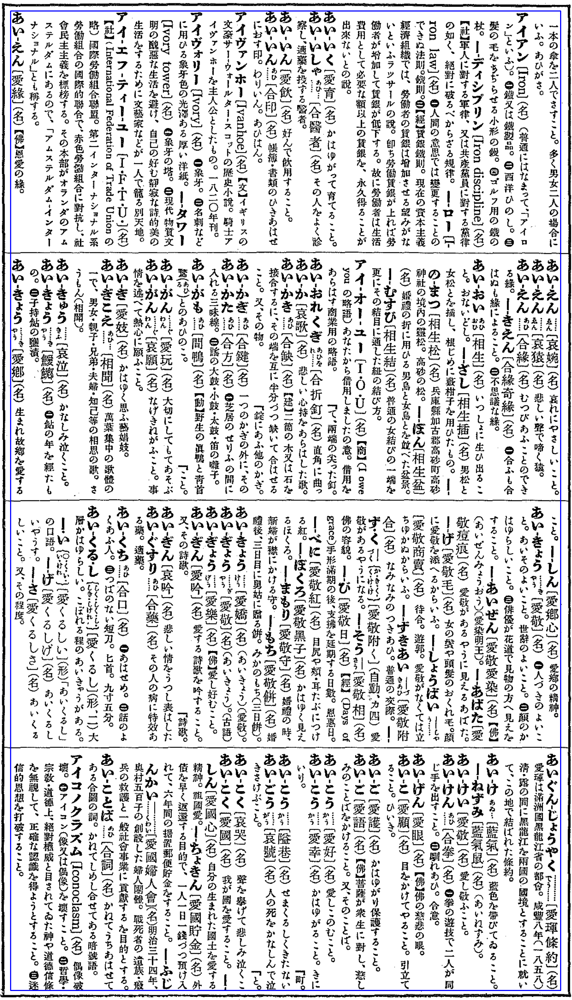

In [12]:
draw_region(source_img1, response, 'blue')

### 3.2 Print Character Boundaries

In [13]:
def draw_boxes(img, bounds, color,width=3):
    image = img
    draw = ImageDraw.Draw(image)
    for bound in bounds:
        if 'locale' in bound.keys():
            None
        else:
            draw.line([
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
            ],fill=color, width=width)
        
    return image

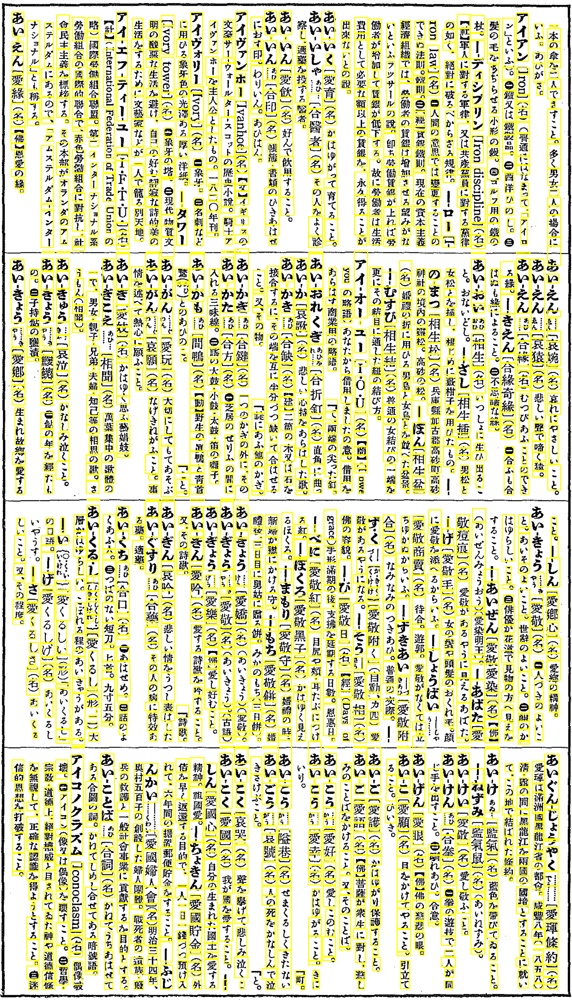

In [14]:
draw_boxes(source_img2, boundaries, 'yellow')

### Print Characters

In [15]:
def draw_characters(img2, bounds, color,width=3):
    image = img2
    draw = ImageDraw.Draw(image)
    # specified font size 
    font = ImageFont.truetype(r'E:\Users\Usuario\Downloads\IPAGTTC00303\IPAGTTC00303\ipag.ttc', 30) 
    for bound in bounds:
        if 'locale' in bound.keys():
            None
        else:
            draw.text((bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                #bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                #bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                #bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                #bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
                      ), bound['description'], align ="center", fill ="black", spacing=1, font = font)

    return img2

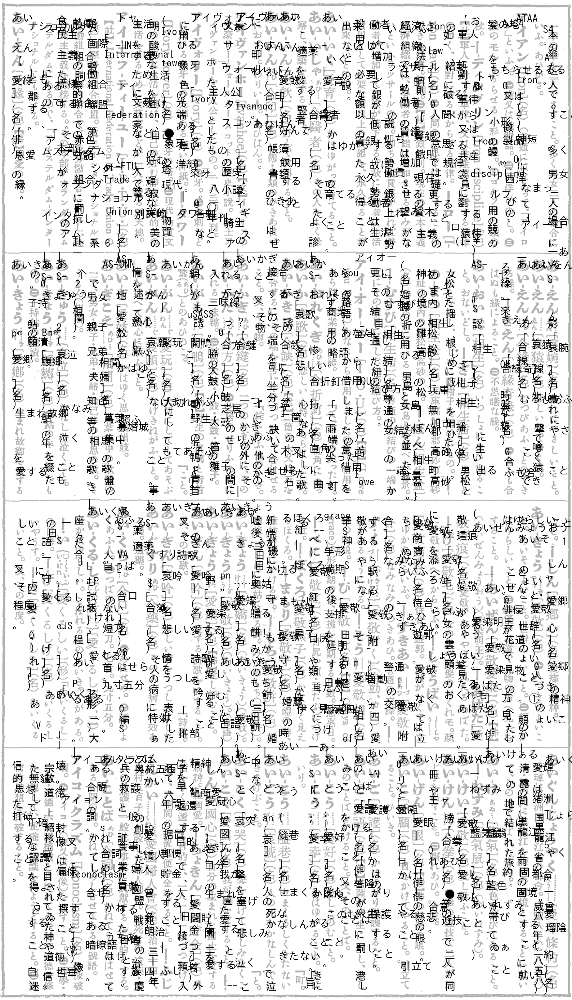

In [16]:
draw_characters(source_img4, boundaries, 'yellow')

# 4 Print characters over the canvas - Language Hints

Extract the boundaries of the regions and characters

In [17]:
boundaries = extract_boundaries(response_ja)
boundaries

[{'locale': 'ja',
  'description': '1本の傘た二人でoすこと。多く男女二人の場合に一あS ん影「哀腕](名) 真れにやさしいこと\nあいをん結(哀猿](名) 悲しい撃で噂く猿。\nATAA (Iron] (4)(神短にはなまって、「アイーロ 一あいえん あ 「合線】(名) むっびあふことのでき\nる繰。ーきえん【合縁奇線](名)0合ふも合\nこと。1しん[愛郷心](名) 愛郷の精神。\n\'(愛敬](名) 0人づきの ょいこ\nと。あいそのょいこと。世辞のょいこと。①顔のか」\nはゆらしいこと。@俳優が花道で見物の方へ見たむ\nあいぐん-じょら5ゃくp一愛瑠陰約〕(名)\n愛輝は猪洲国黒龍江省の都合。威曾八年(一八五八)\n清·露の間に黒龍江を雨固の.固境とすることに就い\nて、の地で結ばれた旅約。\nS4° Aるる°\nャ\nAJS4° O又は 微製品。O西洋びの°\n髪の毛をちちらせる小形の鰻。®ルフ用の競の\nゼ 楽 OK時盤な線。\n·(藍翁](名)藍色た帯びてゐぁこと\nーねずみ(藍気鼠](名) (あいれずみ)\n--あいぜん「愛敬愛染](名) 【俳]|あいけぁる\nお°-トャANリン Iron discipline] (¥)| AS-#S 認【相生】 (): に生い出る\n--ざし【相生播](名)男松と\n女松とた揺し、根じめに戴柑子を 用ひたもの。\nの-まつ[相生松](名) 兵庫無加古郡高砂町高砂\n神社の境内の雛松。高砂の松。|-ぼん(相生盆}\n(名)婚騰の折に用ひる男島と女島とを並べた盆景。\n--むすび「相生結](名) 尊通の女結びの一端か\n(あいぜんみょうおう)(愛染明王)。ーあばた[愛\n敬這痕」(名)愛敬があるやうに見たるあばた。一あいけい【愛敬】(名)愛し敬ふこと\n-げ「愛敬毛](名) 女の雲や頭髪のおくれ毛。\nに愛敬を添へろからいふ。|しょうばい\n[愛敬商賓](名)待合。遊郭。愛敬がなくては立|あいげん[愛眼] (名) 【俳J俳の慈悲の眼。\nちゆかぬからいふ。ーずきあい[愛敬附一あい-と [愛顧】(名)且かけてやること。引立て\n合](名)なみなみのつきぁひ。警通の 交際。\nずく 駅)}[愛敬附~](自動、ヵ四)愛あい-N [愛護](名)かはのがり保護すること。\n敬があるやうになる。

### Print Regions

In [18]:
def draw_region(img, bounds, color,width=3):
    image = img
    draw = ImageDraw.Draw(image)
    for bound in bounds:
        if 'locale' in bound.keys():
            draw.line([
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
            ],fill=color, width=width)
        
    return image

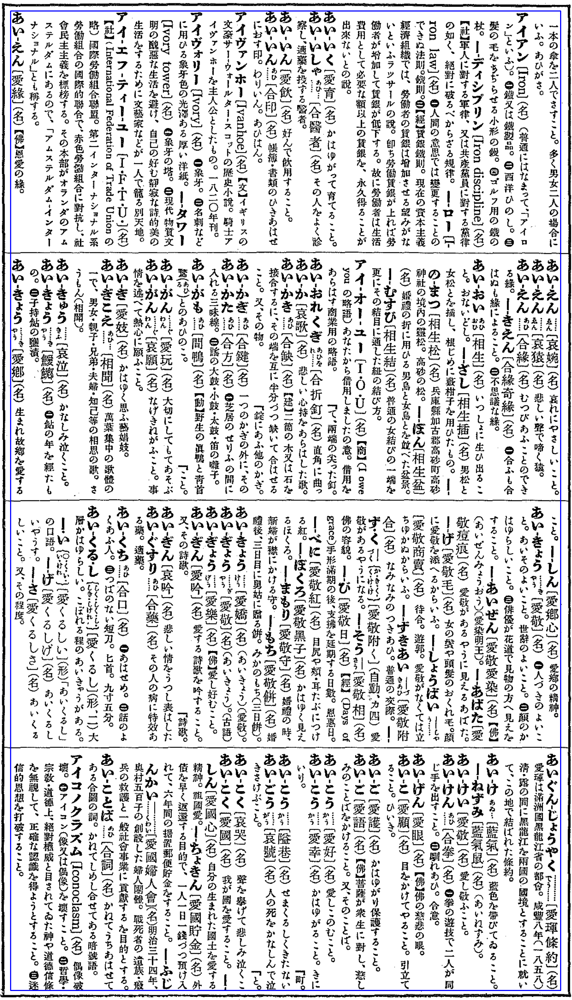

In [19]:
draw_region(source_img5, boundaries, 'blue')

### Print Character Boundaries

In [20]:
def draw_boxes(img, bounds, color,width=3):
    image = img
    draw = ImageDraw.Draw(image)
    for bound in bounds:
        if 'locale' in bound.keys():
            None
        else:
            draw.line([
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
            ],fill=color, width=width)
        
    return image

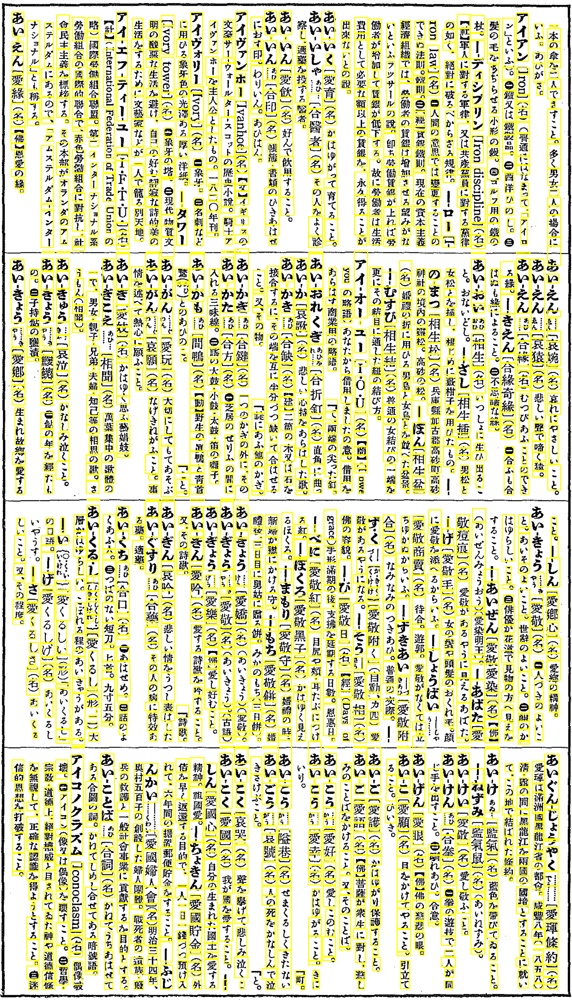

In [21]:
draw_boxes(source_img6, boundaries, 'yellow')

### Print Characters

In [22]:
def draw_characters(img2, bounds, color,width=3):
    image = img2
    draw = ImageDraw.Draw(image)
    # specified font size 
    font = ImageFont.truetype(r'E:\Users\Usuario\Downloads\IPAGTTC00303\IPAGTTC00303\ipag.ttc', 30) 
    for bound in bounds:
        if 'locale' in bound.keys():
            None
        else:
            draw.text((bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y'],
                #bound['boundingPoly']['vertices'][1]['x'], bound['boundingPoly']['vertices'][1]['y'],
                #bound['boundingPoly']['vertices'][2]['x'], bound['boundingPoly']['vertices'][2]['y'],
                #bound['boundingPoly']['vertices'][3]['x'], bound['boundingPoly']['vertices'][3]['y'],
                #bound['boundingPoly']['vertices'][0]['x'], bound['boundingPoly']['vertices'][0]['y']
                      ), bound['description'], align ="center", fill ="black", spacing=1, font = font)

    return img2

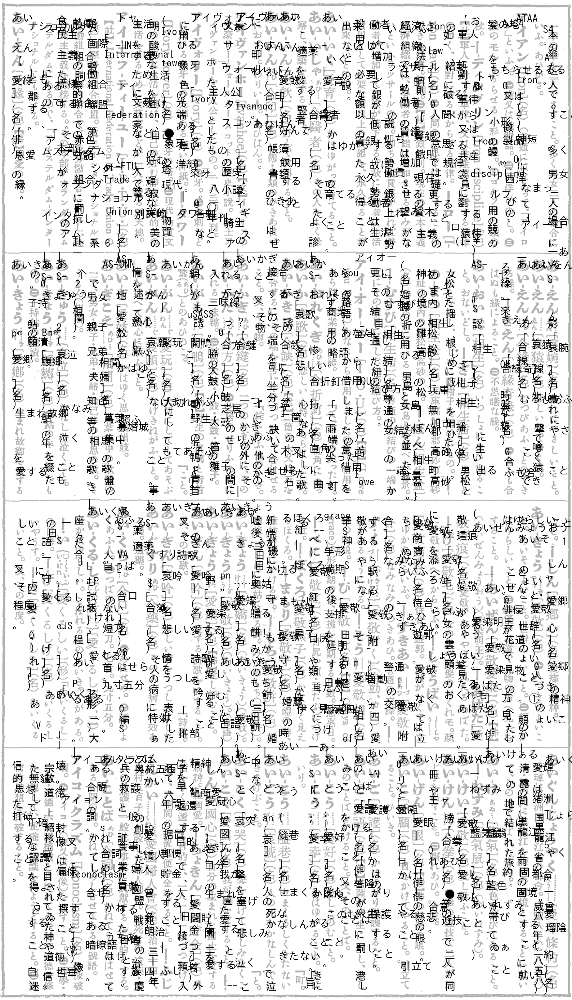

In [23]:
draw_characters(source_img8, boundaries, 'yellow')